In [1]:
from nasbench import api

2024-07-10 15:11:24.309384: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-07-10 15:11:24.367086: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-07-10 15:11:24.368109: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-10 15:11:30.220014: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
nasbench = api.NASBench("/userdata/T0259728/projets/nasbench-master/nasbench_full.tfrecord")

Loading dataset from file... This may take a few minutes...
Instructions for updating:
Use eager execution and: 
`tf.data.TFRecordDataset(path)`
Loaded dataset in 373 seconds


In [24]:
import sys
sys.path.append("..")
import time
import numpy as np
import seaborn as sns
import importlib
import NASBench101Node
from tqdm import tqdm
from MCTS import mcts_agent
import NASBench101MCTS
from nas_bench_201 import NASBench201Node
from nas_bench_301 import NASBench301Node
importlib.reload(NASBench201Node)
importlib.reload(NASBench301Node)
importlib.reload(NASBench101Node)
importlib.reload(NASBench101MCTS)
importlib.reload(mcts_agent)
from NASBench101Node import NASBench101Node, NASBench101Cell
from NASBench101MCTS import NASBench101UCT

In [25]:
root_node = NASBench101Node(state=NASBench101Cell(n_vertices=7))
uct = NASBench101UCT(root_node=root_node, api=nasbench, params_path="/userdata/T0259728/projets/nas/params.json", disable_tqdm=False)
uct.n_iter = 10000
returned_node, all_rewards, best_reward = uct.main_loop()
adjacency, operations = returned_node.state.operations_and_adjacency()
print(adjacency)
print(operations)

100%|████████████████████████████████████| 10000/10000 [00:19<00:00, 501.21it/s]

[[0 1 1 1 0 1 1]
 [0 0 0 0 0 1 0]
 [0 0 0 0 0 1 0]
 [0 0 0 0 1 0 0]
 [0 0 0 0 0 0 0]
 [0 0 0 0 0 0 1]
 [0 0 0 0 0 0 0]]
['input', 'conv3x3-bn-relu', 'conv3x3-bn-relu', 'conv1x1-bn-relu', 'conv1x1-bn-relu', 'conv3x3-bn-relu', 'output']


0.9423410892486572


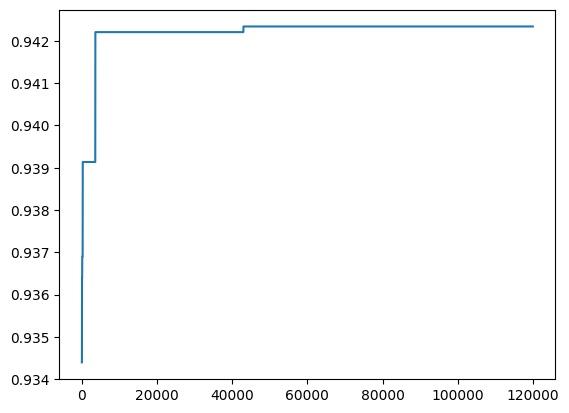

In [19]:
import matplotlib.pyplot as plt
print(best_reward[-1])
plt.plot(best_reward)

## Counting the number of architectures we can make

In [574]:
def play_act(node):
    available_actions = node.get_action_tuples()
    if len(available_actions) == 0:
        adjacency, operations = node.state.operations_and_adjacency()
        model_spec = ModelSpecAPI.ModelSpec(
                # Adjacency matrix of the module
                matrix=adjacency,
                # Operations at the vertices of the module, matches order of matrix
                ops=operations)
        is_valid = nasbench.is_valid(model_spec)
        if is_valid:
            return 1
        else: return 0
    for act in available_actions:
        playout_node.play_action(random_action)
        play_act(playout_node)

for i in tqdm(range(100)):
    node = NASBench101Node(state=NASBench101Cell(n_vertices=7))
    node_type = type(node)
    playout_node = node_type(state=copy.deepcopy(node.state))
    n_archi = 0
    n_


    # is_valid = False
    # while not is_valid:
    #     playout_node = node_type(state=copy.deepcopy(node.state))
    #     while not playout_node.is_terminal():
    #         available_actions = playout_node.get_action_tuples()
    #         random_action = available_actions[np.random.randint(len(available_actions))]
    #         playout_node.play_action(random_action)
    #     adjacency, operations = playout_node.state.operations_and_adjacency()
    #     model_spec = ModelSpecAPI.ModelSpec(
    #             # Adjacency matrix of the module
    #             matrix=adjacency,
    #             # Operations at the vertices of the module, matches order of matrix
    #             ops=operations)
    #     is_valid = nasbench.is_valid(model_spec)
    # adjacency, operations = playout_node.state.operations_and_adjacency()

  0%|                                                   | 0/100 [00:00<?, ?it/s]

(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label',

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_la

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)
(6, 'build_edge', 2)
(6, 'build_edge', 3)
(6, 'build_edge', 4)
ok
(1, 'set_label', 'conv1x1-bn-relu')
(1, 'set_label', 'conv3x3-bn-relu')
(1, 'set_label', 'maxpool3x3')
(2, 'set_label', 'conv1x1-bn-relu')
(2, 'set_label', 'conv3x3-bn-relu')
(2, 'set_label', 'maxpool3x3')
(2, 'build_edge', 0)
(2, 'build_edge', 1)
(3, 'set_label', 'conv1x1-bn-relu')
(3, 'set_label', 'conv3x3-bn-relu')
(3, 'set_label', 'maxpool3x3')
(3, 'build_edge', 0)
(3, 'build_edge', 1)
(3, 'build_edge', 2)
(4, 'set_label', 'conv1x1-bn-relu')
(4, 'set_label', 'conv3x3-bn-relu')
(4, 'set_label', 'maxpool3x3')
(4, 'build_edge', 0)
(4, 'build_edge', 1)
(4, 'build_edge', 2)
(4, 'build_edge', 3)
(5, 'set_label', 'conv1x1-bn-relu')
(5, 'set_label', 'conv3x3-bn-relu')
(5, 'set_label', 'maxpool3x3')
(5, 'build_edge', 0)
(5, 'build_edge', 1)
(5, 'build_edge', 2)
(5, 'build_edge', 3)
(5, 'build_edge', 4)
(6, 'build_edge', 0)
(6, 'build_edge', 1)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
import copy 
from nasbench import api as ModelSpecAPI

n_archi = 0
n_simil = 0
list_adj = []
list_op = []
for i in tqdm(range(100000)):
    node = NASBench101Node(state=NASBench101Cell(n_vertices=7))
    is_valid = False
    while not is_valid:
        node_type = type(node)
        playout_node = node_type(state=copy.deepcopy(node.state))
        while not playout_node.is_terminal():
            available_actions = playout_node.get_action_tuples()
            random_action = available_actions[np.random.randint(len(available_actions))]
            playout_node.play_action(random_action)
        adjacency, operations = playout_node.state.operations_and_adjacency()
        model_spec = ModelSpecAPI.ModelSpec(
                # Adjacency matrix of the module
                matrix=adjacency,
                # Operations at the vertices of the module, matches order of matrix
                ops=operations)
        is_valid = nasbench.is_valid(model_spec)
    adjacency, operations = playout_node.state.operations_and_adjacency()

    # print(adjacency)
    # print(operations)
    # print(list_adj)
    # print(list_op)
    is_in_adj = False
    for adj in list_adj:
        if np.all(adjacency.flatten() == adj):
            is_in_adj = True
    is_in_op = False
    for op in list_op:
        if operations == op:
            is_in_op = True
    # print(f"Adj is in list_adj: {is_in_adj}")
    # print(f"Op is in list_op: {is_in_op}")
    if is_in_adj and is_in_op:
        n_simil += 1
    else:
        n_archi += 1
        list_adj.append(adjacency.flatten())
        list_op.append(operations)
    if i % 1000 == 0:
        print(f"We found {n_archi} different architectures with {n_simil} repeats")
        
print(f"We found {n_archi} different architectures with {n_simil} repeats")

  0%|                                     | 2/100000 [00:00<11:13:54,  2.47it/s]

We found 43371 different architectures with 56630 repeats


  1%|▎                                  | 1002/100000 [03:19<5:27:48,  5.03it/s]

We found 43497 different architectures with 57504 repeats


  2%|▋                                  | 2001/100000 [06:43<5:56:17,  4.58it/s]

We found 43637 different architectures with 58364 repeats


  3%|█                                  | 3001/100000 [10:16<5:38:58,  4.77it/s]

We found 43774 different architectures with 59227 repeats


  4%|█▍                                 | 4001/100000 [13:44<5:45:50,  4.63it/s]

We found 43907 different architectures with 60094 repeats


  5%|█▊                                 | 5001/100000 [17:27<6:16:10,  4.21it/s]

We found 44019 different architectures with 60982 repeats


  6%|██                                 | 6001/100000 [21:08<5:39:33,  4.61it/s]

We found 44142 different architectures with 61859 repeats


  7%|██▍                                | 7001/100000 [24:51<6:27:43,  4.00it/s]

We found 44259 different architectures with 62742 repeats


  8%|██▊                                | 8001/100000 [28:32<5:16:52,  4.84it/s]

We found 44369 different architectures with 63632 repeats


  9%|███▏                               | 9001/100000 [32:15<5:28:30,  4.62it/s]

We found 44481 different architectures with 64520 repeats


 10%|███▍                              | 10001/100000 [36:09<5:50:06,  4.28it/s]

We found 44599 different architectures with 65402 repeats


 11%|███▋                              | 11001/100000 [39:48<5:16:48,  4.68it/s]

We found 44707 different architectures with 66294 repeats


 12%|████                              | 12001/100000 [43:25<5:19:39,  4.59it/s]

We found 44830 different architectures with 67171 repeats


 13%|████▍                             | 13001/100000 [47:04<5:20:05,  4.53it/s]

We found 44933 different architectures with 68068 repeats


 14%|████▊                             | 14001/100000 [50:34<5:08:53,  4.64it/s]

We found 45033 different architectures with 68968 repeats


 15%|█████                             | 15001/100000 [54:05<4:52:17,  4.85it/s]

We found 45119 different architectures with 69882 repeats


 16%|█████▍                            | 16001/100000 [57:36<4:46:35,  4.88it/s]

We found 45205 different architectures with 70796 repeats


 17%|█████▍                          | 17001/100000 [1:01:04<4:47:16,  4.82it/s]

We found 45298 different architectures with 71703 repeats


 18%|█████▊                          | 18001/100000 [1:04:39<5:11:25,  4.39it/s]

We found 45403 different architectures with 72598 repeats


 19%|██████                          | 19001/100000 [1:08:18<5:03:48,  4.44it/s]

We found 45505 different architectures with 73496 repeats


 20%|██████▍                         | 20001/100000 [1:12:02<4:42:31,  4.72it/s]

We found 45585 different architectures with 74416 repeats


 21%|██████▋                         | 21001/100000 [1:15:47<5:23:27,  4.07it/s]

We found 45677 different architectures with 75324 repeats


 22%|███████                         | 22001/100000 [1:19:24<4:32:55,  4.76it/s]

We found 45757 different architectures with 76244 repeats


 23%|███████▎                        | 23001/100000 [1:23:05<5:21:42,  3.99it/s]

We found 45853 different architectures with 77148 repeats


 24%|███████▋                        | 24001/100000 [1:26:44<4:28:30,  4.72it/s]

We found 45934 different architectures with 78067 repeats


 25%|████████                        | 25001/100000 [1:30:17<4:21:37,  4.78it/s]

We found 46018 different architectures with 78983 repeats


 26%|████████▎                       | 26001/100000 [1:33:52<4:32:17,  4.53it/s]

We found 46106 different architectures with 79895 repeats


 27%|████████▋                       | 27001/100000 [1:37:23<4:17:17,  4.73it/s]

We found 46186 different architectures with 80815 repeats


 28%|████████▉                       | 28001/100000 [1:40:55<4:14:39,  4.71it/s]

We found 46271 different architectures with 81730 repeats


 29%|█████████▎                      | 29001/100000 [1:44:35<4:54:29,  4.02it/s]

We found 46348 different architectures with 82653 repeats


 30%|█████████▌                      | 30001/100000 [1:48:31<4:22:37,  4.44it/s]

We found 46424 different architectures with 83577 repeats


 31%|█████████▉                      | 31001/100000 [1:52:10<4:11:37,  4.57it/s]

We found 46500 different architectures with 84501 repeats


 32%|██████████▏                     | 32001/100000 [1:55:47<4:07:10,  4.59it/s]

We found 46565 different architectures with 85436 repeats


 33%|██████████▌                     | 33001/100000 [1:59:23<3:56:21,  4.72it/s]

We found 46649 different architectures with 86352 repeats


 34%|██████████▉                     | 34001/100000 [2:02:59<3:56:26,  4.65it/s]

We found 46723 different architectures with 87278 repeats


 35%|███████████▏                    | 35001/100000 [2:06:34<3:50:24,  4.70it/s]

We found 46787 different architectures with 88214 repeats


 36%|███████████▌                    | 36001/100000 [2:10:21<4:03:44,  4.38it/s]

We found 46860 different architectures with 89141 repeats


 37%|███████████▊                    | 37001/100000 [2:14:05<3:56:57,  4.43it/s]

We found 46920 different architectures with 90081 repeats


 38%|████████████▏                   | 38001/100000 [2:17:54<3:58:40,  4.33it/s]

We found 46987 different architectures with 91014 repeats


 39%|████████████▍                   | 39001/100000 [2:21:41<3:49:16,  4.43it/s]

We found 47048 different architectures with 91953 repeats


 40%|████████████▊                   | 40001/100000 [2:25:26<3:41:19,  4.52it/s]

We found 47102 different architectures with 92899 repeats


 41%|█████████████                   | 41001/100000 [2:29:13<3:36:06,  4.55it/s]

We found 47165 different architectures with 93836 repeats


 42%|█████████████▍                  | 42001/100000 [2:32:59<3:54:29,  4.12it/s]

We found 47218 different architectures with 94783 repeats


 43%|█████████████▊                  | 43001/100000 [2:36:47<3:47:14,  4.18it/s]

We found 47263 different architectures with 95738 repeats


 44%|██████████████                  | 44001/100000 [2:40:41<3:33:09,  4.38it/s]

We found 47320 different architectures with 96681 repeats


 45%|██████████████▍                 | 45001/100000 [2:44:39<3:23:59,  4.49it/s]

We found 47385 different architectures with 97616 repeats


 46%|██████████████▋                 | 46001/100000 [2:48:34<3:33:29,  4.22it/s]

We found 47443 different architectures with 98558 repeats


 47%|███████████████                 | 47001/100000 [2:52:33<3:43:24,  3.95it/s]

We found 47498 different architectures with 99503 repeats


 48%|███████████████▎                | 48001/100000 [2:56:29<3:19:14,  4.35it/s]

We found 47547 different architectures with 100454 repeats


 49%|███████████████▋                | 49001/100000 [3:00:24<3:17:47,  4.30it/s]

We found 47608 different architectures with 101393 repeats


 50%|████████████████                | 50001/100000 [3:04:16<3:08:50,  4.41it/s]

We found 47647 different architectures with 102354 repeats


 51%|████████████████▎               | 51001/100000 [3:08:09<3:06:49,  4.37it/s]

We found 47695 different architectures with 103306 repeats


 52%|████████████████▋               | 52001/100000 [3:12:01<3:02:24,  4.39it/s]

We found 47747 different architectures with 104254 repeats


 53%|████████████████▉               | 53001/100000 [3:15:48<2:59:01,  4.38it/s]

We found 47795 different architectures with 105206 repeats


 54%|█████████████████▎              | 54001/100000 [3:19:37<2:51:02,  4.48it/s]

We found 47850 different architectures with 106151 repeats


 55%|█████████████████▌              | 55001/100000 [3:23:25<2:44:12,  4.57it/s]

We found 47902 different architectures with 107099 repeats


 56%|█████████████████▉              | 56001/100000 [3:27:11<2:43:54,  4.47it/s]

We found 47949 different architectures with 108052 repeats


 57%|██████████████████▏             | 57001/100000 [3:31:00<2:41:16,  4.44it/s]

We found 47998 different architectures with 109003 repeats


 58%|██████████████████▌             | 58001/100000 [3:34:44<2:41:07,  4.34it/s]

We found 48040 different architectures with 109961 repeats


 59%|██████████████████▉             | 59001/100000 [3:38:31<2:32:27,  4.48it/s]

We found 48082 different architectures with 110919 repeats


 60%|███████████████████▏            | 60001/100000 [3:42:17<2:28:23,  4.49it/s]

We found 48119 different architectures with 111882 repeats


 61%|███████████████████▌            | 61001/100000 [3:46:03<2:27:12,  4.42it/s]

We found 48161 different architectures with 112840 repeats


 62%|███████████████████▊            | 62001/100000 [3:49:48<2:15:26,  4.68it/s]

We found 48201 different architectures with 113800 repeats


 63%|████████████████████▏           | 63001/100000 [3:53:34<2:16:24,  4.52it/s]

We found 48240 different architectures with 114761 repeats


 64%|████████████████████▍           | 64001/100000 [3:57:21<2:12:41,  4.52it/s]

We found 48280 different architectures with 115721 repeats


 65%|████████████████████▊           | 65001/100000 [4:01:09<2:10:22,  4.47it/s]

We found 48326 different architectures with 116675 repeats


 66%|█████████████████████           | 66001/100000 [4:04:56<2:08:37,  4.41it/s]

We found 48363 different architectures with 117638 repeats


 67%|█████████████████████▍          | 67001/100000 [4:08:42<2:03:50,  4.44it/s]

We found 48397 different architectures with 118604 repeats


 68%|█████████████████████▊          | 68001/100000 [4:12:27<2:00:36,  4.42it/s]

We found 48427 different architectures with 119574 repeats


 69%|██████████████████████          | 69001/100000 [4:16:14<2:01:29,  4.25it/s]

We found 48459 different architectures with 120542 repeats


 70%|██████████████████████▍         | 70001/100000 [4:19:58<1:47:50,  4.64it/s]

We found 48490 different architectures with 121511 repeats


 71%|██████████████████████▋         | 71001/100000 [4:23:40<1:44:09,  4.64it/s]

We found 48522 different architectures with 122479 repeats


 72%|██████████████████████▉         | 71851/100000 [4:26:51<1:41:21,  4.63it/s]

In [572]:
print(f"We found {n_archi} different architectures with {n_simil} repeats")

We found 20440 different architectures with 5776 repeats


In [ ]:
INPUT = 'input'
OUTPUT = 'output'
CONV1X1 = 'conv1x1-bn-relu'
CONV3X3 = 'conv3x3-bn-relu'
MAXPOOL3X3 = 'maxpool3x3'

In [5]:
model_spec = api.ModelSpec(
  # Adjacency matrix of the module
  matrix=[[0, 1, 1, 1, 0, 1, 0],    # input layer
          [0, 0, 0, 0, 0, 0, 1],    # 1x1 conv
          [0, 0, 0, 0, 0, 0, 1],    # 3x3 conv
          [0, 0, 0, 0, 1, 0, 0],    # 5x5 conv (replaced by two 3x3's)
          [0, 0, 0, 0, 0, 0, 1],    # 5x5 conv (replaced by two 3x3's)
          [0, 0, 0, 0, 0, 0, 1],    # 3x3 max-pool
          [0, 0, 0, 0, 0, 0, 0]],   # output layer
  # Operations at the vertices of the module, matches order of matrix
  ops=[INPUT, CONV1X1, CONV3X3, CONV3X3, CONV3X3, MAXPOOL3X3, OUTPUT])

# Query this model from dataset, returns a dictionary containing the metrics
# associated with this model.
print('Querying an Inception-like model.')
data = nasbench.query(model_spec)
print(data)
print(nasbench.get_budget_counters())   # prints (total time, total epochs)

Querying an Inception-like model.
{'module_adjacency': array([[0, 1, 1, 1, 1, 0, 0],
       [0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 0]], dtype=int8), 'module_operations': ['input', 'conv3x3-bn-relu', 'conv1x1-bn-relu', 'maxpool3x3', 'conv3x3-bn-relu', 'conv3x3-bn-relu', 'output'], 'trainable_parameters': 2694282, 'training_time': 1157.675048828125, 'train_accuracy': 1.0, 'validation_accuracy': 0.9378004670143127, 'test_accuracy': 0.932692289352417}
(1157.675048828125, 108)


In [ ]:
import pandas as pd
import numpy as np
from tqdm import tqdm
print('\nIterating over unique models in the dataset.')
columns=['module_adjacency',
 'module_operations',
 'trainable_parameters',
 'halfway_training_time',
 'halfway_train_accuracy',
 'halfway_validation_accuracy',
 'halfway_test_accuracy',
 'final_training_time',
 'final_train_accuracy',
 'final_validation_accuracy',
 'final_test_accuracy']
df = pd.DataFrame(columns=columns)
i = 0
for unique_hash in tqdm(nasbench.hash_iterator()):
    fixed_metrics, computed_metrics = nasbench.get_metrics_from_hash(
        unique_hash)
    dic = {}
    for k, v in fixed_metrics.items():
        dic[k] = v
    mets= computed_metrics[108]
    for col_name in  ['halfway_training_time', 'halfway_train_accuracy', 'halfway_validation_accuracy', 
                      'halfway_test_accuracy', 'final_training_time', 'final_train_accuracy', 
                      'final_validation_accuracy', 'final_test_accuracy']:
        dic[col_name] = np.mean([e[col_name] for e in mets])
    # For demo purposes, break here instead of iterating through whole set.
    df = df.append(pd.Series(dic), ignore_index=True)
    if i % 100000 == 0:
        df.to_csv("nas_bench_101.csv")
    i += 1

In [152]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
df = pd.read_csv("nas_bench_101.csv")
# f, ax = plt.subplots(figsize=(10,10))
# sns.scatterplot(data=df, x="trainable_parameters", y="final_test_accuracy", s=20)

In [460]:
df2 = df.sort_values(["final_test_accuracy"], ascending=False)
id = 0
print(df2["module_operations"].iloc[id])
print(df2["final_test_accuracy"].iloc[id])
print(df2["module_adjacency"].iloc[id])

['input', 'conv1x1-bn-relu', 'conv3x3-bn-relu', 'maxpool3x3', 'conv3x3-bn-relu', 'conv3x3-bn-relu', 'output']
0.943175752957662
[[0 1 1 0 0 1 1]
 [0 0 0 0 0 1 0]
 [0 0 0 1 0 0 0]
 [0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1]
 [0 0 0 0 0 0 0]]


In [510]:
rd_index = np.random.randint(df.shape[0])
print(df["module_adjacency"].iloc[rd_index])
print(df2["final_test_accuracy"].iloc[rd_index])
df["module_operations"].iloc[rd_index]

[[0 1 0 0 0 0 0]
 [0 0 1 0 0 1 0]
 [0 0 0 1 0 1 1]
 [0 0 0 0 1 0 0]
 [0 0 0 0 0 1 0]
 [0 0 0 0 0 0 1]
 [0 0 0 0 0 0 0]]
0.8908921082814535


"['input', 'maxpool3x3', 'conv1x1-bn-relu', 'conv1x1-bn-relu', 'maxpool3x3', 'conv3x3-bn-relu', 'output']"

In [264]:
import sys
sys.path.append("..")
import time
import numpy as np
import seaborn as sns
import importlib
import MCTS.mcts_agent
import NASBench201MCTS
importlib.reload(MCTS.mcts_agent)
importlib.reload(NASBench201MCTS)
sns.set_context("notebook")
sns.set_theme(sns.plotting_context("notebook", font_scale=1), style="whitegrid", palette=sns.color_palette("deep"))
from MCTS.mcts_agent import MCTSAgent, UCT
from NASBench201MCTS import NASBench201UCT, NASBench201RAVE, NASBench201GRAVE
from nas_201_api import NASBench201API as API

ModuleNotFoundError: No module named 'NASBench201MCTS'

In [ ]:
t1 = time.time()
api = API('/userdata/T0259728/Bureau/NAS-Bench-201-v1_1-096897.pth', verbose=False)
t2 = time.time()
print(f"API inistialized in {t2-t1} seconds.")

In [ ]:
from NASBench201Node import NASBench201Node, NASBench201AMAFNode, NASBench201Cell

In [ ]:
N_RUNS = 20

In [ ]:
avg_rewards_uct = []
avg_best_reward_uct = []

for n_run in range(N_RUNS):
    print(f"[{n_run}/{N_RUNS}]")        
    root_node = NASBench201Node(state=NASBench201Cell(4))
    uct = NASBench201UCT(root_node, api,
                      params_path="/userdata/T0259728/projets/nas/params.json", disable_tqdm=True)
    uct.C = 0.1
    uct.n_iter=500
    uct.playouts_per_selection = 1
    returned_node, all_rewards, best_reward = uct.main_loop()
    avg_rewards_uct.append(all_rewards)
    avg_best_reward_uct.append(best_reward)

In [ ]:
avg_rewards_rave = []
avg_best_reward_rave = []

for n_run in range(N_RUNS):
    try: 
        print(f"{n_run}/{N_RUNS}")
        root_node = NASBench201AMAFNode(state=NASBench201Cell(4))
        rave = NASBench201RAVE(root_node, api,
                          params_path="/userdata/T0259728/projets/nas/params.json", disable_tqdm=True)
        rave.C = 0.1
        rave.b=0.1
        rave.n_iter=500
        rave.playouts_per_selection = 1
        returned_node, all_rewards, best_reward = rave.main_loop()
        avg_rewards_rave.append(all_rewards)
        avg_best_reward_rave.append(best_reward)
    except Exception:
        continue

In [ ]:
avg_rewards_grave = []
avg_best_reward_grave = []

for n_run in range(N_RUNS):
    try: 
        print(f"{n_run}/{N_RUNS}")
        root_node = NASBench201AMAFNode(state=NASBench201Cell(4))
        grave = NASBench201GRAVE(root_node, api,
                          params_path="/userdata/T0259728/projets/nas/params.json", disable_tqdm=True)
        grave.C = 0.1
        grave.b=0.1
        grave.ref = 10
        grave.n_iter=500
        grave.playouts_per_selection = 1
        returned_node, all_rewards, best_reward = grave.main_loop()
        avg_rewards_grave.append(all_rewards)
        avg_best_reward_grave.append(best_reward)
    except Exception:
        continue

In [ ]:
import matplotlib.pyplot as plt
plt.plot(np.mean(np.array(avg_be st_reward_uct), axis=0), label="UCT")
plt.plot(np.mean(np.array(avg_best_reward_rave), axis=0), label="RAVE")
plt.plot(np.mean(np.array(avg_best_reward_grave), axis=0), label="GRAVE")
plt.title("Evolution of the best architecture reward \n 400 iterations"); plt.xlabel("Iteration"); plt.ylabel("CIFAR-100 accuracy"); plt.legend();
plt.ylim([0.56,0.62]);
# plt.savefig("../figures/uct_vs_rave_vs_grave_best_reward_400.png")
plt.show()

In [ ]:
importlib.reload(MCTS.mcts_agent)
importlib.reload(NASBench201MCTS)
from NASBench201MCTS import NASBench201UCT_NTK
import tensorly as tl
tl.set_backend("pytorch")

In [ ]:
avg_rewards_uct_ntk = []
avg_best_reward_uct_ntk = []
avg_accuracies_uct_ntk = []
avg_best_accuracy_uct_ntk = []

for n_run in range(N_RUNS):
    print(f"[{n_run}/{N_RUNS}]")        
    root_node = NASBench201Node(state=NASBench201Cell(4))
    ntk = NASBench201UCT_NTK(root_node, api,
                      params_path="/userdata/T0259728/projets/nas/params.json", disable_tqdm=False)
    ntk.C = 0.1
    ntk.n_iter=400
    ntk.playouts_per_selection = 1
    returned_node, all_rewards, best_reward, all_accuracies, best_accuracies = ntk.main_loop()
    avg_rewards_uct_ntk.append(all_rewards)
    avg_best_reward_uct_ntk.append(best_reward)
    avg_accuracies_uct_ntk.append(all_accuracies)
    avg_best_accuracy_uct_ntk.append(best_accuracies)

In [ ]:
import matplotlib.pyplot as plt
# plt.plot(np.mean(np.array(avg_best_reward_uct), axis=0), label="UCT")
f, ax1 = plt.subplots()
ax1.plot(np.mean(np.array(avg_best_reward_uct_ntk), axis=0), label="NTK Metric", color="#3d405b")
ax1.set_ylabel("NTK Metric")

ax2 = ax1.twinx()
ax2.plot(np.mean(np.array(avg_best_accuracy_uct_ntk), axis=0), label="Accuracy", color="#e07a5f")
ax2.set_ylabel("CIFAR-100 accuracy")

plt.title("Evolution of the best architecture reward \n 400 iterations"); plt.xlabel("Iteration"); plt.ylabel("CIFAR-100 accuracy"); 
plt.legend();
# plt.ylim([0.56,0.62]);
plt.savefig("../figures/ntk_metric.png")
plt.show()

In [ ]:
plt.plot(np.mean(np.array(avg_best_reward_uct_ntk), axis=0), label="kzjnj")

In [ ]:
avg_best_reward_uct_ntk